## MSDS 452
## Assignment 4

# <span style="color:green">Twitter Networks

In [1]:
from tweepy import *
 

# For sending GET requests from the API
import requests
# For saving access tokens and for file management when creating and adding to the dataset
import os
# For dealing with json responses we receive from the API
import json
# For displaying the data after
import pandas as pd
# For saving the response data in CSV format
import csv
# For parsing the dates received from twitter in readable formats
import datetime
import dateutil.parser
import unicodedata
#To add wait time between requests
import time
 

In [2]:
pip install preprocessor

  Created wheel for preprocessor: filename=preprocessor-1.1.3-py3-none-any.whl size=4477 sha256=0e1d6f5b12897cc4330187c56b329d9f1eeebea174eb0f7cf8071b6d33a3950f
  Stored in directory: /root/.cache/pip/wheels/0e/b7/36/aa37256db62b4bfd35a6f1b5536e9ba843f257b79dcbf3d5f1
Successfully built preprocessor


In [3]:
!pip install tweepy

In [4]:
pip install twitter

     |████████████████████████████████| 50 kB 2.7 MB/s 


In [5]:
pip install emoji

     |████████████████████████████████| 174 kB 5.5 MB/s 
  Created wheel for emoji: filename=emoji-1.6.3-py3-none-any.whl size=170298 sha256=b8554c322bd210f61ca2ae5239d148a119f8fc283d17216a67a41214bd60bd04
  Stored in directory: /root/.cache/pip/wheels/03/8b/d7/ad579fbef83c287215c0caab60fb0ae0f30c4d7ce5f580eade
Successfully built emoji


In [6]:
!apt install libgraphviz-dev
!pip install pygraphviz

Reading package lists... Done
Building dependency tree       
Reading state information... Done
The following packages were automatically installed and are no longer required:
  cuda-command-line-tools-10-0 cuda-command-line-tools-10-1
  cuda-command-line-tools-11-0 cuda-compiler-10-0 cuda-compiler-10-1
  cuda-compiler-11-0 cuda-cuobjdump-10-0 cuda-cuobjdump-10-1
  cuda-cuobjdump-11-0 cuda-cupti-10-0 cuda-cupti-10-1 cuda-cupti-11-0
  cuda-cupti-dev-11-0 cuda-documentation-10-0 cuda-documentation-10-1
  cuda-documentation-11-0 cuda-documentation-11-1 cuda-gdb-10-0 cuda-gdb-10-1
  cuda-gdb-11-0 cuda-gpu-library-advisor-10-0 cuda-gpu-library-advisor-10-1
  cuda-libraries-10-0 cuda-libraries-10-1 cuda-libraries-11-0
  cuda-memcheck-10-0 cuda-memcheck-10-1 cuda-memcheck-11-0 cuda-nsight-10-0
  cuda-nsight-10-1 cuda-nsight-11-0 cuda-nsight-11-1 cuda-nsight-compute-10-0
  cuda-nsight-compute-10-1 cuda-nsight-compute-11-0 cuda-nsight-compute-11-1
  cuda-nsight-systems-10-1 cuda-nsight-systems-

In [7]:
pip install chart_studio

     |████████████████████████████████| 64 kB 2.0 MB/s 
  Created wheel for retrying: filename=retrying-1.3.3-py3-none-any.whl size=11447 sha256=cbe318798a1f9d19bc8384f2a007aad51eade5bc5a60d1381efe2252f7045933
  Stored in directory: /root/.cache/pip/wheels/f9/8d/8d/f6af3f7f9eea3553bc2fe6d53e4b287dad18b06a861ac56ddf
Successfully built retrying


In [8]:
pip install datashader

     |████████████████████████████████| 15.8 MB 5.0 MB/s 
     |████████████████████████████████| 76 kB 3.2 MB/s 
     |████████████████████████████████| 133 kB 62.9 MB/s 
     |████████████████████████████████| 830 kB 41.5 MB/s 
     |████████████████████████████████| 822 kB 37.4 MB/s 
     |████████████████████████████████| 802 kB 49.4 MB/s 
     |████████████████████████████████| 802 kB 69.7 MB/s 
     |████████████████████████████████| 793 kB 43.0 MB/s 
     |████████████████████████████████| 793 kB 45.8 MB/s 
     |████████████████████████████████| 791 kB 45.8 MB/s 
     |████████████████████████████████| 786 kB 51.9 MB/s 
     |████████████████████████████████| 779 kB 43.1 MB/s 
     |████████████████████████████████| 778 kB 42.2 MB/s 
     |████████████████████████████████| 776 kB 65.5 MB/s 
     |████████████████████████████████| 769 kB 53.7 MB/s 
     |████████████████████████████████| 766 kB 69.0 MB/s 
     |████████████████████████████████| 1.0 MB 57.1 MB/s 
     |██████████

In [9]:
pip install hvplot

     |████████████████████████████████| 3.1 MB 5.4 MB/s 


Creating /root/.bokeh directory
Creating /root/.bokeh/data directory
Using data directory: /root/.bokeh/data
Downloading: CGM.csv (1589982 bytes)
   1589982 [100.00%]
Downloading: US_Counties.zip (3171836 bytes)
   3171836 [100.00%]
Unpacking: US_Counties.csv
Downloading: us_cities.json (713565 bytes)
    713565 [100.00%]
Downloading: unemployment09.csv (253301 bytes)
    253301 [100.00%]
Downloading: AAPL.csv (166698 bytes)
    166698 [100.00%]
Downloading: FB.csv (9706 bytes)
      9706 [100.00%]
Downloading: GOOG.csv (113894 bytes)
    113894 [100.00%]
Downloading: IBM.csv (165625 bytes)
    165625 [100.00%]
Downloading: MSFT.csv (161614 bytes)
    161614 [100.00%]
Downloading: WPP2012_SA_DB03_POPULATION_QUINQUENNIAL.zip (4816256 bytes)
   4816256 [100.00%]
Unpacking: WPP2012_SA_DB03_POPULATION_QUINQUENNIAL.csv
Downloading: gapminder_fertility.csv (64346 bytes)
     64346 [100.00%]
Downloading: gapminder_population.csv (94509 bytes)
     94509 [100.00%]
Downloading: gapminder_life_e

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
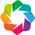

In [10]:
import twitter, re, emoji, random, operator, os, math, re, string, copy, itertools, pickle, datetime, pandas as pd, numpy as np, matplotlib.pyplot as plt, networkx as nx
from urllib.request import urlopen
from zipfile import ZipFile
from io import BytesIO
from collections import Counter, OrderedDict
import operator
from wordcloud import WordCloud
import pygraphviz
from networkx.drawing.nx_agraph import graphviz_layout
from networkx.algorithms import community
import community as louvain
import spacy 

# Plotting-related
import matplotlib
import matplotlib.pyplot as plt
from matplotlib.patches import Rectangle
# from matplotlib import pyplot as plt
# from matplotlib.gridspec import GridSpec
from matplotlib.ticker import FuncFormatter
import matplotlib.colors as mcolors
import matplotlib._color_data as mcd
%matplotlib inline
import seaborn as sns
import plotly
from plotly import tools
# import plotly.plotly as py
import chart_studio.plotly as py
import plotly.graph_objs as go
import plotly.figure_factory as ff
from plotly.offline import download_plotlyjs,init_notebook_mode,plot,iplot
#connects JS to notebook so plots work inline
init_notebook_mode(connected=True)
# import bokeh
# from bokeh.io import push_notebook, show, output_notebook
# import bokeh.plotting as bp
# from bokeh.plotting import figure, save, output_file, show
# from bokeh.models import (ColumnDataSource, LabelSet, Label, BoxSelectTool, Circle, EdgesAndLinkedNodes, HoverTool,MultiLine, NodesAndLinkedEdges, Plot, Range1d, TapTool,)
# output_notebook()
# import holoviews as hv
# from holoviews import dim, opts
# hv.extension('bokeh', 'matplotlib')
# from holoviews.operation.datashader import datashade, bundle_graph
# import hvplot.pandas
# from holoviews.operation import gridmatrix
# # import IPython
# from IPython.display import display, HTML, Image
# # hv.notebook_extension()

import bokeh
from bokeh.io import push_notebook, show, output_notebook, save
import bokeh.plotting as bp
from bokeh.plotting import figure, save, output_file, show #, from_networkx
from bokeh.models import (ColumnDataSource, LabelSet, Label, BoxSelectTool, Circle, EdgesAndLinkedNodes, HoverTool,MultiLine, NodesAndLinkedEdges, Plot, Range1d, TapTool,)
from holoviews.element.graphs import layout_nodes
bokeh.sampledata.download()
from bokeh.sampledata.airport_routes import routes, airports

output_notebook()
import holoviews as hv
from holoviews import dim, opts
hv.extension('bokeh', 'matplotlib')
from holoviews.operation import  gridmatrix
from holoviews.operation.datashader import datashade, bundle_graph
from holoviews import Graph, Nodes
from holoviews.plotting.bokeh import GraphPlot, LabelsPlot
import hvplot.networkx as hvnx
import hvplot.pandas

import warnings
warnings.filterwarnings("ignore", category=RuntimeWarning) 
warnings.simplefilter('ignore')

In [13]:
# Twitter dataset - https://archive.org/details/twitter-ira

from google.colab import drive
drive.mount('/content/gdrive/')

Drive already mounted at /content/gdrive/; to attempt to forcibly remount, call drive.mount("/content/gdrive/", force_remount=True).


In [14]:
path = '/content/gdrive/MyDrive/MSDS452/'

#**Data Loading and Preprocessing**

In [15]:
# el_data = pd.read_csv(path + 'election16tw.csv', error_bad_lines=False, engine = 'python', encoding_errors = 'ignore')

In [16]:
# el_df = el_data[el_data['tweet_language'] == 'en']
# el_df.tail()

In [17]:
# #the orginal dataset has more than 1.7 millions rows, which is quite time-consuming to parse, trimmed down to 50k rows with time stretching more than 15 days verified
# el_df.tail(50000).to_csv(path +'en_last50k.csv')

In [18]:
df= pd.read_csv(path + 'en_last50k.csv')
df.head(30)

,Unnamed: 0,tweetid,userid,user_display_name,user_screen_name,user_reported_location,user_profile_description,user_profile_url,follower_count,following_count,account_creation_date,account_language,tweet_language,tweet_text,tweet_time,tweet_client_name,in_reply_to_tweetid,in_reply_to_userid,quoted_tweet_tweetid,is_retweet,retweet_userid,retweet_tweetid,latitude,longitude,quote_count,reply_count,like_count,retweet_count,hashtags,urls,user_mentions,poll_choices
0,1644723,834863885937041408,4272870988,Pamela Moore,Pamela_Moore13,"Texas, USA",Southern. Conservative. Pro God. Anti Racism,NaN,72121,42080,2015-11-25,en,en,lol... buying tweets and followers to seem mor...,2017-02-23 20:33,Twitter Web Client,NaN,NaN,NaN,False,NaN,NaN,NaN,NaN,17.0,8.0,140.0,158.0,[cnnleaks],[],NaN,NaN
1,1644724,891047233306669061,4272870988,Pamela Moore,Pamela_Moore13,"Texas, USA",Southern. Conservative. Pro God. Anti Racism,NaN,72121,42080,2015-11-25,en,en,"Democrat Congessman Dennis Kucinich: ""Obama w...",2017-07-28 21:26,Twitter Web Client,NaN,NaN,NaN,False,NaN,NaN,NaN,NaN,21.0,22.0,430.0,488.0,[],[],NaN,NaN
2,1644725,777935590289354752,4272870988,Pamela Moore,Pamela_Moore13,"Texas, USA",Southern. Conservative. Pro God. Anti Racism,NaN,72121,42080,2015-11-25,en,en,Donald Trump: Hillary Clinton has 'emboldened ...,2016-09-19 18:21,Twitter Web Client,NaN,NaN,NaN,False,NaN,NaN,NaN,NaN,6.0,2.0,62.0,93.0,[],[http://insider.foxnews.com/2016/09/19/donald-...,NaN,NaN
3,1644726,800057431216640000,4272870988,Pamela Moore,Pamela_Moore13,"Texas, USA",Southern. Conservative. Pro God. Anti Racism,NaN,72121,42080,2015-11-25,en,en,"State Sen. Doug Ericksen: ""You cannot do harm ...",2016-11-19 19:25,Twitter Web Client,NaN,NaN,NaN,False,NaN,NaN,NaN,NaN,8.0,17.0,158.0,168.0,[NotMyPresident],[],NaN,NaN
4,1644727,841366392901402625,4272870988,Pamela Moore,Pamela_Moore13,"Texas, USA",Southern. Conservative. Pro God. Anti Racism,NaN,72121,42080,2015-11-25,en,en,#BLM activist was arrested for human trafficki...,2017-03-13 19:12,Twitter Web Client,NaN,NaN,NaN,False,NaN,NaN,NaN,NaN,43.0,41.0,265.0,412.0,[BLM],[],NaN,NaN
5,1644728,805957504869875712,4272870988,Pamela Moore,Pamela_Moore13,"Texas, USA",Southern. Conservative. Pro God. Anti Racism,NaN,72121,42080,2015-11-25,en,en,#Florida GOP Elector: I Get 4000 Harassing Ema...,2016-12-06 02:10,Twitter Web Client,NaN,NaN,NaN,False,NaN,NaN,NaN,NaN,68.0,50.0,770.0,1276.0,[Florida],[],NaN,NaN
6,1644729,539807932796268544,09c3b6feef2625474374066b50ebc77942a667bdfa14c7...,09c3b6feef2625474374066b50ebc77942a667bdfa14c7...,09c3b6feef2625474374066b50ebc77942a667bdfa14c7...,USA,No great man ever complains of want of opportu...,NaN,27,154,2014-08-27,en,en,Strain every nerve to gain your point.,2014-12-02 15:46,Twitter Web Client,NaN,NaN,NaN,False,NaN,NaN,NaN,NaN,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN
7,1644730,549840088759144449,09c3b6feef2625474374066b50ebc77942a667bdfa14c7...,09c3b6feef2625474374066b50ebc77942a667bdfa14c7...,09c3b6feef2625474374066b50ebc77942a667bdfa14c7...,USA,No great man ever complains of want of opportu...,NaN,27,154,2014-08-27,en,en,Be decisive. A wrong decision is generally les...,2014-12-30 08:11,Twitter Web Client,NaN,NaN,NaN,False,NaN,NaN,NaN,NaN,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN
8,1644750,793824153338056704,2882037326,Dana Gold,DanaGeezus,USA,Producer,NaN,24920,12434,2014-10-29,en,en,RT @OilegorAerep: #SometimesItsOkTo drink deca...,2016-11-02 14:36,TweetDeck,NaN,NaN,NaN,True,976032427,7.938235e+17,NaN,NaN,0.0,0.0,0.0,0.0,[SometimesItsOkTo],[],[976032427],NaN
9,1644751,734741906152792064,2882037326,Dana Gold,DanaGeezus,USA,Producer,NaN,24920,12434,2014-10-29,en,en,RT @Violetrose9801: you try to imitate other c...,2016-05-23 13:44,TweetDeck,NaN,NaN,NaN,True,3590711121,7.347417e+17,NaN,NaN,0.0,0.0,0.0,0.0,[SignsYouAreAmerican],[],[3590711121],NaN


In [19]:
#test data time horizon
print(df['tweet_time'].max())
print(df['tweet_time'].min())
print(len(df['tweet_time'].unique()))

2018-05-14 21:39
2013-08-27 22:08
46363


In [20]:
df_a4 = df.copy()
df_a4['tweet_time'] = pd.to_datetime(df_a4['tweet_time'])

df_a4.drop(['tweet_text', 'poll_choices', 'latitude',	'longitude', 'account_language', 'account_creation_date'], axis=1, inplace=True)

In [21]:
print(len(df_a4['in_reply_to_userid'].unique()))
print(len(df_a4['retweet_userid'].unique()))
print(len(df_a4['user_mentions'].unique()))

1044
7957
11827


In [22]:
df_a4['hashtags'] = df_a4['hashtags'].str.replace('[', '').str.replace(']', '').str.split(',')

In [23]:
df_a4['user_mentions'] = df_a4['user_mentions'].str.replace('[', '').str.replace(']', '').str.split(',')

In [219]:
df_a4.head(5)

,Unnamed: 0,tweetid,userid,user_display_name,user_screen_name,user_reported_location,user_profile_description,user_profile_url,follower_count,following_count,tweet_language,tweet_time,tweet_client_name,in_reply_to_tweetid,in_reply_to_userid,quoted_tweet_tweetid,is_retweet,retweet_userid,retweet_tweetid,quote_count,reply_count,like_count,retweet_count,hashtags,urls,user_mentions,Date
0,1644723,834863885937041408,4272870988,Pamela Moore,Pamela_Moore13,"Texas, USA",Southern. Conservative. Pro God. Anti Racism,NaN,72121,42080,en,2017-02-23 20:33:00,Twitter Web Client,NaN,NaN,NaN,False,NaN,NaN,17.0,8.0,140.0,158.0,[cnnleaks],[],NaN,2017-02-23
1,1644724,891047233306669061,4272870988,Pamela Moore,Pamela_Moore13,"Texas, USA",Southern. Conservative. Pro God. Anti Racism,NaN,72121,42080,en,2017-07-28 21:26:00,Twitter Web Client,NaN,NaN,NaN,False,NaN,NaN,21.0,22.0,430.0,488.0,[],[],NaN,2017-07-28
2,1644725,777935590289354752,4272870988,Pamela Moore,Pamela_Moore13,"Texas, USA",Southern. Conservative. Pro God. Anti Racism,NaN,72121,42080,en,2016-09-19 18:21:00,Twitter Web Client,NaN,NaN,NaN,False,NaN,NaN,6.0,2.0,62.0,93.0,[],[http://insider.foxnews.com/2016/09/19/donald-...,NaN,2016-09-19
3,1644726,800057431216640000,4272870988,Pamela Moore,Pamela_Moore13,"Texas, USA",Southern. Conservative. Pro God. Anti Racism,NaN,72121,42080,en,2016-11-19 19:25:00,Twitter Web Client,NaN,NaN,NaN,False,NaN,NaN,8.0,17.0,158.0,168.0,[NotMyPresident],[],NaN,2016-11-19
4,1644727,841366392901402625,4272870988,Pamela Moore,Pamela_Moore13,"Texas, USA",Southern. Conservative. Pro God. Anti Racism,NaN,72121,42080,en,2017-03-13 19:12:00,Twitter Web Client,NaN,NaN,NaN,False,NaN,NaN,43.0,41.0,265.0,412.0,[BLM],[],NaN,2017-03-13


In [25]:
AllHashtags=[]
for i in range(len(df_a4)):
    ent=df_a4.iloc[i]["hashtags"]
    if isinstance(ent, float):
      pass
    else:
      for e in ent:
         AllHashtags.append(e)
print("Hashtags",len(AllHashtags),len(set(AllHashtags))) #54405 7662

AllMentions=[]
for i in range(len(df_a4)):
    ent=df_a4.iloc[i]["user_mentions"]
    if isinstance(ent, float):
      pass
    else:
      for e in ent:
        AllMentions.append(e)
print("Mentions",len(AllMentions),len(set(AllMentions))) #431965 20


AllRetweet=[]
for i in range(len(df_a4)):
    ent=df_a4.iloc[i]["retweet_userid"]
    if isinstance(ent, float):
      pass
    else:
      for e in ent:
        AllRetweet.append(e)
print("Reweet",len(AllRetweet),len(set(AllRetweet))) #207940 16

Hashtags 54405 7662
Mentions 31180 19163
Reweet 207940 16


In [26]:
df_a4['Date'] = df_a4['tweet_time'].dt.strftime('%d %b %Y')
df_a4["Date"] = pd.to_datetime(df_a4["Date"])

In [27]:
columns = ['userid', 'user_screen_name', 'tweet_time', 'retweet_userid', 'retweet_count', 'hashtags', 'user_mentions', 'Date']

df_base = df_a4[columns].copy()
df_base = df_base.sort_values(by='Date')

df_base.head()

,userid,user_screen_name,tweet_time,retweet_userid,retweet_count,hashtags,user_mentions,Date
40017,c6fdb5b31b765db7e3378b1e23b86ea2b0eb3c03e8db56...,c6fdb5b31b765db7e3378b1e23b86ea2b0eb3c03e8db56...,2013-08-27 22:08:00,NaN,0.0,NaN,[60167522],2013-08-27
40359,c6fdb5b31b765db7e3378b1e23b86ea2b0eb3c03e8db56...,c6fdb5b31b765db7e3378b1e23b86ea2b0eb3c03e8db56...,2013-11-10 20:59:00,329196034,0.0,[voteaustinmahone],[329196034],2013-11-10
5414,37d430eaa0177389f28dec662391346d00e77d4db53a03...,37d430eaa0177389f28dec662391346d00e77d4db53a03...,2013-11-20 12:06:00,486631666,0.0,"[RETWEET, ad]","[228270250, 486631666]",2013-11-20
49618,37d430eaa0177389f28dec662391346d00e77d4db53a03...,37d430eaa0177389f28dec662391346d00e77d4db53a03...,2013-11-23 09:08:00,486631666,0.0,NaN,[486631666],2013-11-23
23968,37d430eaa0177389f28dec662391346d00e77d4db53a03...,37d430eaa0177389f28dec662391346d00e77d4db53a03...,2013-11-23 09:25:00,347561607,0.0,"[RETWEET, TeamFollowBack, TeamAutoFollow, I...",[347561607],2013-11-23


In [28]:
def counter(val):
  if isinstance(val, float):
    t = 0
  else:
    t = len(val)
  return t

df_base['no_hash'] = df_base['hashtags'].apply(counter)
df_base['no_mention'] = df_base['user_mentions'].apply(counter)

In [29]:
df_base.head()

,userid,user_screen_name,tweet_time,retweet_userid,retweet_count,hashtags,user_mentions,Date,no_hash,no_mention
40017,c6fdb5b31b765db7e3378b1e23b86ea2b0eb3c03e8db56...,c6fdb5b31b765db7e3378b1e23b86ea2b0eb3c03e8db56...,2013-08-27 22:08:00,NaN,0.0,NaN,[60167522],2013-08-27,0,1
40359,c6fdb5b31b765db7e3378b1e23b86ea2b0eb3c03e8db56...,c6fdb5b31b765db7e3378b1e23b86ea2b0eb3c03e8db56...,2013-11-10 20:59:00,329196034,0.0,[voteaustinmahone],[329196034],2013-11-10,1,1
5414,37d430eaa0177389f28dec662391346d00e77d4db53a03...,37d430eaa0177389f28dec662391346d00e77d4db53a03...,2013-11-20 12:06:00,486631666,0.0,"[RETWEET, ad]","[228270250, 486631666]",2013-11-20,2,2
49618,37d430eaa0177389f28dec662391346d00e77d4db53a03...,37d430eaa0177389f28dec662391346d00e77d4db53a03...,2013-11-23 09:08:00,486631666,0.0,NaN,[486631666],2013-11-23,0,1
23968,37d430eaa0177389f28dec662391346d00e77d4db53a03...,37d430eaa0177389f28dec662391346d00e77d4db53a03...,2013-11-23 09:25:00,347561607,0.0,"[RETWEET, TeamFollowBack, TeamAutoFollow, I...",[347561607],2013-11-23,6,1


In [30]:
df1 = df_base.copy()
gf1 = df1.groupby(['userid','Date']).agg({'tweet_time':lambda x: list(x), 
                                          'retweet_userid':lambda x: list(x), 
                                          'hashtags':lambda x: list(x), 
                                          'user_mentions':lambda x: list(x)
                                          }).reset_index()

gf1["no_tweets"]=gf1.tweet_time.map(len)
gf1 = gf1.sort_values(by='Date')
len(gf1)

31240

In [133]:
df2 = df_base.copy()
gf2 = df2.groupby(['Date']).agg({'tweet_time':lambda x: list(x), 
                                          'retweet_userid':lambda x: list(x), 
                                          'hashtags':lambda x: list(x), 
                                          'user_mentions':lambda x: list(x),
                                          'user_screen_name': lambda x: list(x)
                                          }).reset_index()

gf2["no_tweets"]=gf2.tweet_time.map(len)
gf2["no_sender"]=gf2.user_screen_name.map(len)
gf2['Date'] = pd.to_datetime(gf2['Date'])
gf2 = gf2.sort_values(by='Date')
len(gf2) 
gf2.head(20) 

,Date,tweet_time,retweet_userid,hashtags,user_mentions,user_screen_name,no_tweets,no_sender
0,2013-08-27,[2013-08-27 22:08:00],[nan],[nan],[[60167522]],[c6fdb5b31b765db7e3378b1e23b86ea2b0eb3c03e8db5...,1,1
1,2013-11-10,[2013-11-10 20:59:00],[329196034],[[voteaustinmahone]],[[329196034]],[c6fdb5b31b765db7e3378b1e23b86ea2b0eb3c03e8db5...,1,1
2,2013-11-20,[2013-11-20 12:06:00],[486631666],"[[RETWEET, ad]]","[[228270250, 486631666]]",[37d430eaa0177389f28dec662391346d00e77d4db53a0...,1,1
3,2013-11-23,"[2013-11-23 09:08:00, 2013-11-23 09:25:00, 201...","[486631666, 347561607, 486631666]","[nan, [RETWEET, TeamFollowBack, TeamAutoFoll...","[[486631666], [347561607], [486631666]]",[37d430eaa0177389f28dec662391346d00e77d4db53a0...,3,3
4,2013-11-27,"[2013-11-27 11:59:00, 2013-11-27 07:00:00]","[nan, 486631666]","[[soundcloud], [RETWEET, TeamFollowBack, Fol...","[nan, [486631666]]",[d2857a1f930016f6118ec3d00058b9ff687b54e49a85c...,2,2
5,2013-12-10,[2013-12-10 13:23:00],[nan],[[spbstrategy2030]],[nan],[eeb98f72837186582339c2ffb6ca701975a74c8479894...,1,1
6,2014-01-17,"[2014-01-17 10:16:00, 2014-01-17 10:16:00]","[486631666, 486631666]","[nan, [AUTOFOLLOW, TEAMFOLLOWBACK, RETWEET, ...","[[486631666], [996745718, 486631666]]",[37d430eaa0177389f28dec662391346d00e77d4db53a0...,2,2
7,2014-03-12,[2014-03-12 06:23:00],[nan],[nan],[nan],[fb6e3b08a283366fbffc928534aaf4ac7959b5f9bc19f...,1,1
8,2014-03-16,[2014-03-16 03:55:00],[nan],[[GageSayings]],[nan],[ce1cc785c30e34edfad6ce998eaeaab192d66855518de...,1,1
9,2014-03-17,[2014-03-17 21:24:00],[nan],[nan],[nan],[fb6e3b08a283366fbffc928534aaf4ac7959b5f9bc19f...,1,1


In [134]:
def flatli(val):
  try:
    return [item for sublist in val for item in sublist]
  except(TypeError):
    pass

In [141]:
def flatli_re(val):
  try:
    return [x for x in val if pd.isnull(x) == False]
  except(TypeError):
    pass

In [147]:


no_tweeple=[]
no_unique_tweeple=[]
no_hashtags=[]
no_unique_hashtags=[]
no_mentions=[]
no_unique_mentions=[]
list_mentioned_tweeple=[]
list_hashtags=[]
list_senders=[]
no_retweets=[]
no_unique_retweets=[]
list_retweets=[]
for i in range(len(gf2)):
    tweeple=gf2.iloc[i]["user_screen_name"]
    no_tweeple.append(len(tweeple))
    no_unique_tweeple.append(len(set(tweeple)))

    hashtags=gf2.iloc[i]["hashtags"]
    t1= flatli(hashtags)
    if (t1 is None):
        no_hashtags.append(0)
        no_unique_hashtags.append(0)
    else:
        no_hashtags.append(len(t1))
        no_unique_hashtags.append(len(set(t1)))
    list_hashtags.append(t1)

    mentions=gf2.iloc[i]["user_mentions"]
    t2= flatli(mentions)
    if (t2 is None):
        no_mentions.append(0)
        no_unique_mentions.append(0)
    else:
        no_mentions.append(len(t2))
        no_unique_mentions.append(len(set(t2)))
    list_mentioned_tweeple.append(t2)
   
    retweet = gf2.iloc[i]['retweet_userid']
    t3= flatli_re(retweet)
    if (t3 is None):
        no_retweets.append(0)
        no_unique_retweets.append(0)
    else:
        no_retweets.append(len(t3))
        no_unique_retweets.append(len(set(t3)))
    list_retweets.append(t3)

gf2["No. of Senders Tweeple"]=no_tweeple
gf2["No. of Unique Senders Tweeple"]=no_unique_tweeple
gf2["No. of Hashtags"]=no_hashtags
gf2["No. of Unique Hashtags"]=no_unique_hashtags
gf2["No. of Mentioned Tweeple"]=no_mentions
gf2["No. of Unique Mentioned Tweeple"]=no_unique_mentions
gf2["No. of Retweets"]=no_retweets
gf2["No. of Unique Retweets"]=no_unique_retweets
gf2["List of Hashtags"]=list_hashtags
gf2["List of Mentioned Tweeple"]=list_mentioned_tweeple
gf2["List of Retweets"]=list_retweets

gf2=gf2[["Date","tweet_time", "no_tweets","user_screen_name","No. of Unique Senders Tweeple","List of Hashtags","No. of Unique Hashtags","List of Mentioned Tweeple","No. of Unique Mentioned Tweeple", "List of Retweets","No. of Unique Retweets"]]
gf2.head()

,Date,tweet_time,no_tweets,user_screen_name,No. of Unique Senders Tweeple,List of Hashtags,No. of Unique Hashtags,List of Mentioned Tweeple,No. of Unique Mentioned Tweeple,List of Retweets,No. of Unique Retweets
0,2013-08-27,[2013-08-27 22:08:00],1,[c6fdb5b31b765db7e3378b1e23b86ea2b0eb3c03e8db5...,1,None,0,[60167522],1,[],0
1,2013-11-10,[2013-11-10 20:59:00],1,[c6fdb5b31b765db7e3378b1e23b86ea2b0eb3c03e8db5...,1,[voteaustinmahone],1,[329196034],1,[329196034],1
2,2013-11-20,[2013-11-20 12:06:00],1,[37d430eaa0177389f28dec662391346d00e77d4db53a0...,1,"[RETWEET, ad]",2,"[228270250, 486631666]",2,[486631666],1
3,2013-11-23,"[2013-11-23 09:08:00, 2013-11-23 09:25:00, 201...",3,[37d430eaa0177389f28dec662391346d00e77d4db53a0...,1,None,0,"[486631666, 347561607, 486631666]",2,"[486631666, 347561607, 486631666]",2
4,2013-11-27,"[2013-11-27 11:59:00, 2013-11-27 07:00:00]",2,[d2857a1f930016f6118ec3d00058b9ff687b54e49a85c...,2,"[soundcloud, RETWEET, TeamFollowBack, Follow...",4,None,0,[486631666],1


<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
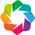

:Layout
   .Curve.Number_of_Tweets_per_Day                   :Curve   [Date]   (no_tweets)
   .Curve.Number_of_Unique_Senders_Tweeple_per_Day   :Curve   [Date]   (No. of Unique Senders Tweeple)
   .Curve.Number_of_Unique_Hashtags_per_Day          :Curve   [Date]   (No. of Unique Hashtags)
   .Curve.Number_of_Unique_Mentioned_Tweeple_per_Day :Curve   [Date]   (No. of Unique Mentioned Tweeple)
   .Curve.Number_of_Unique_Retweets_per_Day          :Curve   [Date]   (No. of Unique Retweets)

In [148]:
hv.extension('bokeh')

gd1a=gf2[["Date","no_tweets"]] #,"No. of Unique Senders Tweeple","No. of Unique Hashtags","No. of Unique Mentioned Tweeple"]]
gd1a['Date'] = pd.to_datetime(gd1a['Date'], format='%Y-%m-%d')
gd1a["Date"] = gd1a["Date"].dt.strftime('%Y-%m-%d')
twplotsa=gd1a.hvplot(x='Date',stacked=True, legend='top_left')
sst='Number of Tweets per Day' #, Senders Tweeple, Hashtags and Mentioned Tweeple per Date'
twplotsa=twplotsa.relabel(sst).opts(title=sst,width=450,height=300,shared_axes=False,tools=['hover'],xrotation=90, yformatter='%.0f')

gd1b=gf2[["Date","No. of Unique Senders Tweeple"]] #,,"",""]]
gd1b['Date'] = pd.to_datetime(gd1b['Date'], format='%Y-%m-%d')
gd1b["Date"] = gd1b["Date"].dt.strftime('%Y-%m-%d')
twplotsb=gd1b.hvplot(x='Date',stacked=True, legend='top_left')
sst='Number of Unique Senders Tweeple per Day' #, Senders Tweeple, Hashtags and Mentioned Tweeple per Date'
twplotsb=twplotsb.relabel(sst).opts(title=sst,width=450,height=300,shared_axes=False,tools=['hover'],xrotation=90, yformatter='%.0f',color="orange")

gd1c=gf2[["Date","No. of Unique Hashtags"]] #,"No. of Unique Senders Tweeple","No. of Unique Hashtags","No. of Unique Mentioned Tweeple"]]
gd1c['Date'] = pd.to_datetime(gd1c['Date'], format='%Y-%m-%d')
gd1c["Date"] = gd1c["Date"].dt.strftime('%Y-%m-%d')
twplotsc=gd1c.hvplot(x='Date',stacked=True, legend='top_left')
sst='Number of Unique Hashtags per Day' #, Senders Tweeple, Hashtags and Mentioned Tweeple per Date'
twplotsc=twplotsc.relabel(sst).opts(title=sst,width=450,height=300,shared_axes=False,tools=['hover'],xrotation=90, yformatter='%.0f',color="green")

gd1d=gf2[["Date","No. of Unique Mentioned Tweeple"]] #,"No. of Unique Senders Tweeple","No. of Unique Hashtags","No. of Unique Mentioned Tweeple"]]
gd1d['Date'] = pd.to_datetime(gd1d['Date'], format='%Y-%m-%d')
gd1d["Date"] = gd1d["Date"].dt.strftime('%Y-%m-%d')
twplotsd=gd1d.hvplot(x='Date',stacked=True, legend='top_left')
sst='Number of Unique Mentioned Tweeple per Day' #, Senders Tweeple, Hashtags and Mentioned Tweeple per Date'
twplotsd=twplotsd.relabel(sst).opts(title=sst,width=450,height=300,shared_axes=False,tools=['hover'],xrotation=90, yformatter='%.0f',color="red")

gd1e=gf2[["Date","No. of Unique Retweets"]] #,"No. of Unique Senders Tweeple","No. of Unique Hashtags","No. of Unique Mentioned Tweeple"]]
gd1e['Date'] = pd.to_datetime(gd1e['Date'], format='%Y-%m-%d')
gd1e["Date"] = gd1e["Date"].dt.strftime('%Y-%m-%d')
twplotse=gd1e.hvplot(x='Date',stacked=True, legend='top_left')
sst='Number of Unique Retweets per Day' #, Senders Tweeple, Hashtags and Mentioned Tweeple per Date'
twplotse=twplotse.relabel(sst).opts(title=sst,width=450,height=300,shared_axes=False,tools=['hover'],xrotation=90, yformatter='%.0f',color="cyan")

layout = hv.Layout(twplotsa + twplotsb + twplotsc +  twplotsd + twplotse).cols(2)
layout

In [149]:
ct=list(set(df2["user_screen_name"].unique()).intersection(set(AllMentions)))
data = {'No. of Tweets': len(df2),
        'No. of Hashtags':len(set(AllHashtags)),
        'No. of Senders Tweeple': len(df2["userid"].unique()),
        'No. of Mentioned Tweeple': len(set(AllMentions)),
        'No. of Senders-Mentioned Tweeple':len(ct),
        'No. of Retweets':len(df2["retweet_userid"].unique()),
        }
gdt = pd.DataFrame (data, columns = ["No. of Tweets","No. of Hashtags","No. of Senders Tweeple","No. of Mentioned Tweeple","No. of Senders-Mentioned Tweeple",'No. of Retweets'], index=["Total"])
gdt

,No. of Tweets,No. of Hashtags,No. of Senders Tweeple,No. of Mentioned Tweeple,No. of Senders-Mentioned Tweeple,No. of Retweets
Total,50000,7662,1920,19163,259,7957


In [218]:
len(ct)

259

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
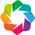

:Labels   [x,y]   (Label)

In [150]:
hv.extension('bokeh')
du1=gf2.T
du1=du1.reset_index()
du1
sst="Basic Counts (during %i days from %s to %s)" %(len(gf2),min(df2['tweet_time']),max(df2['tweet_time']))
plot=du1.hvplot.bar(legend='top_right').opts(title=sst,width=800,height=500,color='index', cmap='Category10', yformatter='%.0f',xrotation=15)
xs, ys = plot.dimension_values(0),plot.dimension_values(1)
ys = np.array([float(x) for x in ys])
labels = hv.Labels((xs, ys-0.03*float(ys.max()), ys),  dataset=plot.dataset)
labels=labels(opts.Labels(text_color="white")) 
labels

In [36]:
plot.dimensions()

[Dimension('index'), Dimension('Variable'), Dimension('value')]

In [176]:
# def connected_component_subgraphs(G):
#     for c in nx.connected_components(G):
#         yield G.subgraph(c)

def hvnx_plot(G,ctype,pos,width,height,node_size,node_cmap,edge_color,edge_line_width,
              title,bundled,nodelabels,xoffset,yoffset,
              arrowhead_length,selection_mode,selection_policy,
              edge_hover_line_color,node_hover_fill_color,
              fontsize,text_font_size, text_color,bgcolor):
    if nx.is_directed(G)==True:
        in_neighbors={} #arriving_airlines={}
        for n in G.nodes():
            t=list(G.predecessors(n))
            in_neighbors[n]=", ".join(sorted([x for x in t]))
#         print(in_neighbors)
        out_neighbors={} #departing_airlines={}
        for n in G.nodes():
            t=list(G.successors(n))
            out_neighbors[n]=", ".join(sorted([x for x in t])) 
#         print(out_neighbors)
        if ctype==1:
            communities_generator = community.girvan_newman(G)
            top_level_communities = next(communities_generator)
            next_level_communities = next(communities_generator)
            lc=sorted(sorted(map(sorted, next_level_communities)), key=len,reverse=True)
            partition={n:i for i,c in enumerate(lc) for n in c }
            print("No. of Girvan-Newman communities",len(set(partition.values())))
            for n in G.nodes():
                G.nodes[n]['Girvan_Newman_community'] = partition[n]
#                 if (n,n) in G.edges():
#                     G.nodes[n]['in-degree'] = 0
#                     G.nodes[n]['in-neighbors'] = ""
#                     G.nodes[n]['out-degree'] = 0
#                     G.nodes[n]['out-neighbors'] = ""
#                 else:    
                G.nodes[n]['in-degree'] = G.in_degree(n)
                G.nodes[n]['in_neighbors'] = in_neighbors[n] 
#                     G.nodes[n]['arriving airlines'] = arriving_airlines[n] 
                G.nodes[n]['out-degree'] = G.out_degree(n)
                G.nodes[n]['out_neighbors'] = out_neighbors[n] 
#                     G.nodes[n]['departing airlines'] = departing_airlines[n] 
            graph = hvnx.draw(G, pos)
            graph.opts(edge_color=edge_color,edge_line_width=edge_line_width,node_size=node_size,node_color='Girvan_Newman_community',node_cmap=node_cmap)
            if bundled==0:                
                graph.opts(selection_policy=selection_policy,title=title,edge_hover_line_color=edge_hover_line_color,node_hover_fill_color=node_hover_fill_color,fontsize=fontsize,width=width,height=height,arrowhead_length=arrowhead_length) #,tools=tools) #,'box_zoom',"tap"])
                if nodelabels==1:
                    labels = hv.Labels(graph.nodes, ['x', 'y'], 'index')
                    graph=(graph * labels.opts(xoffset=xoffset, yoffset=yoffset,text_font_size=text_font_size, text_color=text_color, bgcolor=bgcolor))
                    print(labels)
                    return graph
                else:
                    return graph
            else:
                graph = bundle_graph(graph)
                graph.opts(selection_policy=selection_policy,title=title,edge_hover_line_color=edge_hover_line_color,node_hover_fill_color=node_hover_fill_color,fontsize=fontsize,width=width,height=height,arrowhead_length=arrowhead_length) #,tools=tools) #,'box_zoom',"tap"])
                if nodelabels==1:
                    labels = hv.Labels(graph.nodes, ['x', 'y'], 'index')
                    graph=(graph * labels.opts(xoffset=xoffset, yoffset=yoffset,text_font_size=text_font_size, text_color=text_color, bgcolor=bgcolor))
                    return graph
                else:
                    return graph
        if ctype==0:
            print("Louvain communities are not computable for directed graphs!")
    else:
        connections={}
        for n in G.nodes():
            t=list(G.neighbors(n))
            connections[n]=", ".join(sorted([x for x in t]))
#         connected_components={}
#         Gcc = sorted(connected_component_subgraphs(G), key = len, reverse=True)
#         ccl=[list(g.nodes) for g in Gcc]
#     #     ccl=sorted(ccl, key=lambda item: len(item[1]), reverse=True)
#         for i,j in enumerate(ccl):
#             for n in j:
#                 connected_components[n]=i 
        if ctype==1:
            communities_generator = community.girvan_newman(G)
            top_level_communities = next(communities_generator)
            #next_level_communities = next(communities_generator)
            #lc=sorted(sorted(map(sorted, next_level_communities)), key=len,reverse=True)
            partition={n:i for i,c in enumerate(lc) for n in c }
#             print("No. of connected components",len(ccl))
            print("No. of Girvan-Newman communities",len(set(partition.values())))
            for n in G.nodes():
                G.nodes[n]['Girvan-Newman_community'] = partition[n]
#                 if (n,n) in G.edges():
#                     G.nodes[n]['degree'] = 0
#                     G.nodes[n]['connections'] = ""
# #                     G.nodes[n]['connected_component'] = connected_components[n]
#                 else:    
                G.nodes[n]['degree'] = G.degree(n)
                G.nodes[n]['connections'] = connections[n] #", ".join([str(x) for x in list(G.neighbors(n))])
#                     G.nodes[n]['connected_component'] = connected_components[n]
    #         for n in G.nodes():
    #             G.nodes[n]['Louvain_community'] = partition[n]
            graph = hvnx.draw(G, pos)
            graph.opts(edge_color=edge_color,edge_line_width=edge_line_width,node_size=node_size,node_color='Girvan-Newman_community',node_cmap=node_cmap)
            graph.opts(padding=0.15)
            if bundled==0:
                graph.opts(selection_policy=selection_policy,title=title,edge_hover_line_color=edge_hover_line_color,node_hover_fill_color=node_hover_fill_color,fontsize=fontsize,width=width,height=height,arrowhead_length=arrowhead_length) #,tools=tools) #,'box_zoom',"tap"])
                if nodelabels==1:
                    labels = hv.Labels(graph.nodes, ['x', 'y'], 'index')
                    graph=(graph * labels.opts(xoffset=xoffset, yoffset=yoffset,text_font_size=text_font_size, text_color=text_color, bgcolor=bgcolor))            
                    return graph
                else:
                    return graph
            else:
                graph = bundle_graph(graph)
                graph.opts(selection_policy=selection_policy,title=title,edge_hover_line_color=edge_hover_line_color,node_hover_fill_color=node_hover_fill_color,fontsize=fontsize,width=width,height=height,arrowhead_length=arrowhead_length) #,tools=tools) #,'box_zoom',"tap"])
                if nodelabels==1:
                    labels = hv.Labels(graph.nodes, ['x', 'y'], 'index')
                    graph=(graph * labels.opts(xoffset=xoffset, yoffset=yoffset,text_font_size=text_font_size, text_color=text_color, bgcolor=bgcolor))
                    return graph
                else:
                    return graph
        if ctype==0:
            partition_l=louvain.best_partition(G)
#             print("No. of connected components",len(ccl))
            print("No. of Louvain communities",len(set(partition_l.values())))
            for n in G.nodes():
                G.nodes[n]['Louvain_community'] = partition_l[n]
                if (n,n) in G.edges():
                    G.nodes[n]['degree'] = 0
                    G.nodes[n]['connections'] = ""
        #             G.nodes[n]['connected_component'] = connected_components[n]
                else:    
                    G.nodes[n]['degree'] = G.degree(n)
                    G.nodes[n]['connections'] = connections[n] #", ".join([str(x) for x in list(G.neighbors(n))])  #connections          
        #             G.nodes[n]['connected_component'] = connected_components[n]
            graph = hvnx.draw(G, pos)
            graph.opts(edge_color=edge_color,edge_line_width=edge_line_width,node_size=node_size,node_color='Louvain_community',node_cmap=node_cmap)
            graph.opts(padding=0.15)
            if bundled==0:                
                graph.opts(selection_policy=selection_policy,title=title,edge_hover_line_color=edge_hover_line_color,node_hover_fill_color=node_hover_fill_color,fontsize=fontsize,width=width,height=height,arrowhead_length=arrowhead_length) #,tools=tools) #,'box_zoom',"tap"])
                if nodelabels==1:
                    labels = hv.Labels(graph.nodes, ['x', 'y'], 'index')
                    graph=(graph * labels.opts(xoffset=xoffset, yoffset=yoffset,text_font_size=text_font_size, text_color=text_color, bgcolor=bgcolor))
                    return graph
                else:
                    return graph
            else:
                graph = bundle_graph(graph)
                graph.opts(selection_policy=selection_policy,title=title,edge_hover_line_color=edge_hover_line_color,node_hover_fill_color=node_hover_fill_color,fontsize=fontsize,width=width,height=height,arrowhead_length=arrowhead_length) #,tools=tools) #,'box_zoom',"tap"])
                if nodelabels==1:
                    labels = hv.Labels(graph.nodes, ['x', 'y'], 'index')
                    graph=(graph * labels.opts(xoffset=xoffset, yoffset=yoffset,text_font_size=text_font_size, text_color=text_color, bgcolor=bgcolor))
                    return graph
                else:
                    return graph

#**Attempt to visualize co-occurent hashtags of tweets on certain date

In [152]:
days=sorted([str(d)[:10] for d in df2["Date"].unique()])

GGh={}
for day in days:
    dfd=df2[df2["Date"]==day]
    meds=[]
    for i in range(len(dfd)):
        hashtags=dfd.iloc[i]["hashtags"]
        if isinstance(hashtags, float):
           pass
        else:
           if len(hashtags)>1:
              aa=list(itertools.combinations(hashtags,2))
              for j in aa:
                  meds.append((j[0],j[1]))
    maeds=[]
    for k,v in Counter(meds).items():
        maeds.append((k[0],k[1],v)) 
    Ghm=nx.MultiGraph()
    Ghm.add_weighted_edges_from(maeds)
    weight=[(x, y, {'weight': v}) for (x, y), v in Counter(Ghm.edges()).items()]
    Gh = nx.Graph(weight)
    print("The graph of co-occurrent hashtags (in tweets) on %s has %i nodes and %i edges" %(day,len(Gh.nodes()),len(Gh.edges())))
    GGh[day]=Gh

The graph of co-occurrent hashtags (in tweets) on 2013-08-27 has 0 nodes and 0 edges
The graph of co-occurrent hashtags (in tweets) on 2013-11-10 has 0 nodes and 0 edges
The graph of co-occurrent hashtags (in tweets) on 2013-11-20 has 2 nodes and 1 edges
The graph of co-occurrent hashtags (in tweets) on 2013-11-23 has 6 nodes and 15 edges
The graph of co-occurrent hashtags (in tweets) on 2013-11-27 has 3 nodes and 3 edges
The graph of co-occurrent hashtags (in tweets) on 2013-12-10 has 0 nodes and 0 edges
The graph of co-occurrent hashtags (in tweets) on 2014-01-17 has 5 nodes and 10 edges
The graph of co-occurrent hashtags (in tweets) on 2014-03-12 has 0 nodes and 0 edges
The graph of co-occurrent hashtags (in tweets) on 2014-03-16 has 0 nodes and 0 edges
The graph of co-occurrent hashtags (in tweets) on 2014-03-17 has 0 nodes and 0 edges
The graph of co-occurrent hashtags (in tweets) on 2014-03-19 has 0 nodes and 0 edges
The graph of co-occurrent hashtags (in tweets) on 2014-03-20 ha

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
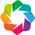

No. of Girvan-Newman communities 8
No. of Girvan-Newman communities 6
No. of Girvan-Newman communities 7
No. of Girvan-Newman communities 6


:Layout
   .Graph.I   :Graph   [start,end]   (weight)
   .Graph.II  :Graph   [start,end]   (weight)
   .Graph.III :Graph   [start,end]   (weight)
   .Graph.IV  :Graph   [start,end]   (weight)

In [153]:
hv.extension('bokeh')

# Let us consider 4 days during which the number of tweets (nodes of the corresponding graph of hashtags) is moderately high:

#The graph of co-occurrent hashtags (in tweets) on 2015-03-18 has 30 nodes and 81 edges
#The graph of co-occurrent hashtags (in tweets) on 2015-01-08 has 19 nodes and 32 edges
#The graph of co-occurrent hashtags (in tweets) on 2014-09-17 has 18 nodes and 41 edges
#The graph of co-occurrent hashtags (in tweets) on 2015-02-16 has 23 nodes and 39 edges

fourDays=["2015-03-18","2015-01-08","2014-09-17","2015-02-16"]

ctype=1
node_color="Girvan-Newman_community"  #'Louvain_community' "connected_component"
bundled=1
nodelabels=0
width=500
height=500
node_size=2*np.log(5+hv.dim('degree')) #4*np.log(6+hv.dim('in-degree'))
node_cmap="tab10"
edge_line_width=1
edge_color='olive'
arrowhead_length=0.04
selection_mode='nodes'
selection_policy="nodes"
edge_hover_line_color='green'
node_hover_fill_color='red'
fontsize={'title': '9pt'}
text_font_size='4pt'
text_color='black'
bgcolor='white'
xoffset=0
yoffset=-0.03 #-15
    
Gh=GGh[fourDays[0]]
title="%s" %fourDays[0]
pos=graphviz_layout(Gh)
g0=hvnx_plot(Gh,ctype,pos,width,height,node_size,node_cmap,edge_color,edge_line_width,
             title,bundled,nodelabels,xoffset,yoffset,
             arrowhead_length,selection_mode,selection_policy,
             edge_hover_line_color,node_hover_fill_color,
             fontsize,text_font_size, text_color,bgcolor)
g0

Gh=GGh[fourDays[1]]
title="%s" %fourDays[1]
pos=graphviz_layout(Gh)
g1=hvnx_plot(Gh,ctype,pos,width,height,node_size,node_cmap,edge_color,edge_line_width,
             title,bundled,nodelabels,xoffset,yoffset,
             arrowhead_length,selection_mode,selection_policy,
             edge_hover_line_color,node_hover_fill_color,
             fontsize,text_font_size, text_color,bgcolor)

Gh=GGh[fourDays[2]]
title="%s" %fourDays[2]
pos=graphviz_layout(Gh)
g2=hvnx_plot(Gh,ctype,pos,width,height,node_size,node_cmap,edge_color,edge_line_width,
             title,bundled,nodelabels,xoffset,yoffset,
             arrowhead_length,selection_mode,selection_policy,
             edge_hover_line_color,node_hover_fill_color,
             fontsize,text_font_size, text_color,bgcolor)

Gh=GGh[fourDays[3]]
title="%s" %fourDays[3]
pos=graphviz_layout(Gh)
g3=hvnx_plot(Gh,ctype,pos,width,height,node_size,node_cmap,edge_color,edge_line_width,
             title,bundled,nodelabels,xoffset,yoffset,
             arrowhead_length,selection_mode,selection_policy,
             edge_hover_line_color,node_hover_fill_color,
             fontsize,text_font_size, text_color,bgcolor)

layout = hv.Layout(g0 + g1 + g2 + g3).cols(2)
layout.opts(title="The graphs of co-occurrent hashtags (in tweets) on %i days (colored in Girvan-Newman communities)" %len(fourDays))

#**Attempt to visualize Mentions among tweeple on certain date

In [223]:
GGm={}
dmeds=[]
for i in range(len(gf2)):
    source=[x for x in gf2.iloc[i]["user_screen_name"] if x in ct]
    if (gf2.iloc[i]["List of Mentioned Tweeple"] is None):
      pass
    else:
      target=[y for y in gf2.iloc[i]["List of Mentioned Tweeple"] if y in ct]
    day=str(gf2.iloc[i]["Date"])[:10]
    if len(source)>0 and len(target)>0:
        for x in source:
            for y in target:
                dmeds.append((x,y,{'day': day}))
    Gm=nx.MultiDiGraph()
    Gm.add_edges_from(dmeds)
    selfs=[e for e in Gm.edges() if e[0]==e[1]]
    Gm.remove_edges_from(selfs)
    isols=[n for n in Gm.nodes() if Gm.in_degree(n)==0 and Gm.out_degree(n)==0]
    Gm.remove_nodes_from(isols)
    #print("The graph of mentions among tweeple on %s has %i nodes and %i edges" %(day,len(Gm.nodes()),len(Gm.edges())))
    GGm[day]=Gm

The graph of mentions among tweeple on 2013-08-27 has 0 nodes and 0 edges
The graph of mentions among tweeple on 2013-11-10 has 0 nodes and 0 edges
The graph of mentions among tweeple on 2013-11-20 has 0 nodes and 0 edges
The graph of mentions among tweeple on 2013-11-23 has 0 nodes and 0 edges
The graph of mentions among tweeple on 2013-11-27 has 0 nodes and 0 edges
The graph of mentions among tweeple on 2013-12-10 has 0 nodes and 0 edges
The graph of mentions among tweeple on 2014-01-17 has 0 nodes and 0 edges
The graph of mentions among tweeple on 2014-03-12 has 0 nodes and 0 edges
The graph of mentions among tweeple on 2014-03-16 has 0 nodes and 0 edges
The graph of mentions among tweeple on 2014-03-17 has 0 nodes and 0 edges
The graph of mentions among tweeple on 2014-03-19 has 0 nodes and 0 edges
The graph of mentions among tweeple on 2014-03-20 has 0 nodes and 0 edges
The graph of mentions among tweeple on 2014-03-21 has 0 nodes and 0 edges
The graph of mentions among tweeple on

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
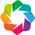

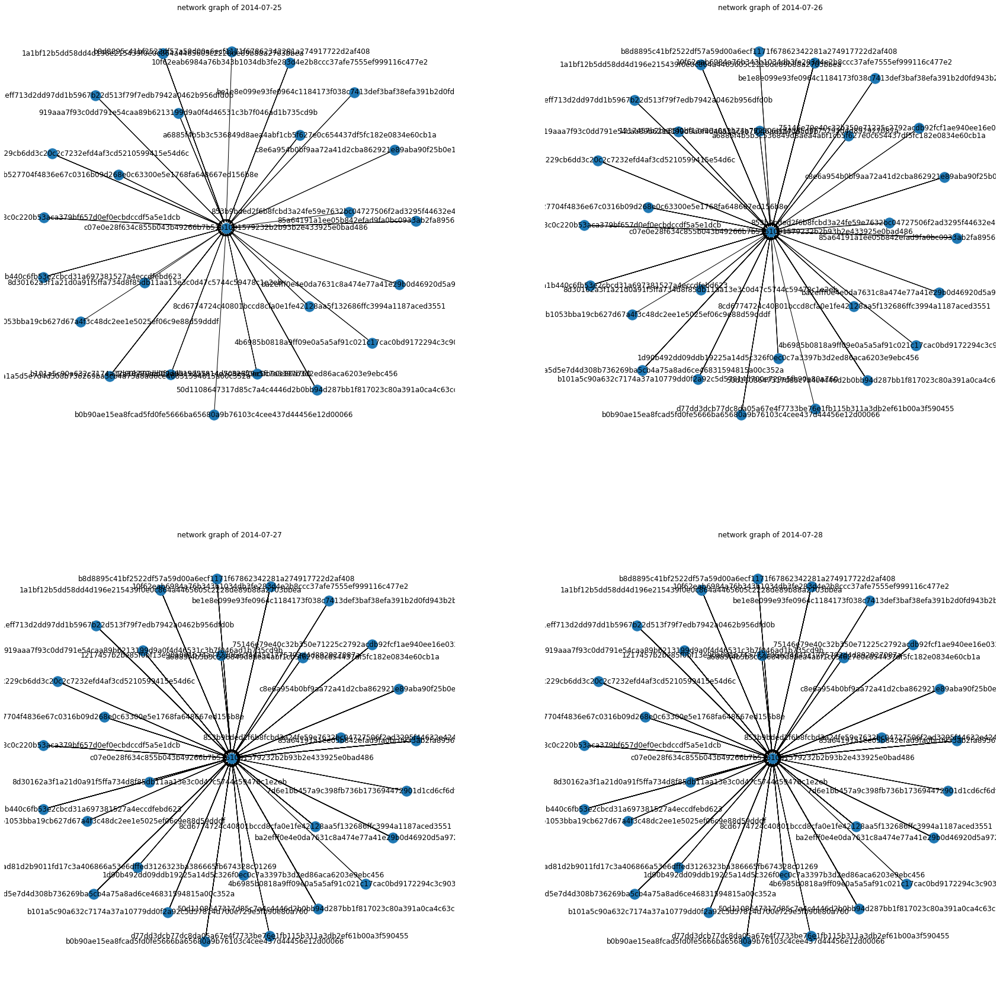

In [228]:
# Let us consider 4 days during which the number of tweets (nodes of the corresponding graph of mentions) is moderately high:

hv.extension('bokeh')
fourDays=["2014-07-25","2014-07-26","2014-07-27", "2014-07-28"] #due to computational complexity, reduce to only one day for showing purpose

ctype=1
node_color="Girvan-Newman_community"  #'Louvain_community' "connected_component"
bundled=0
nodelabels=0
width=500
height=500
node_size=15 #15*np.log(5+hv.dim('in_degree')) #4*np.log(6+hv.dim('in-degree'))
node_cmap="tab10"
edge_line_width=1
edge_color='lightgreen'
arrowhead_length=0.04
selection_mode='nodes'
selection_policy="nodes"
edge_hover_line_color='green'
node_hover_fill_color='red'
fontsize={'title': '9pt'}
text_font_size='4pt'
text_color='black'
bgcolor='white'
xoffset=0
yoffset=-0.03 #-15
    
fig, ((ax0, ax1), (ax2, ax3)) = plt.subplots (nrows=2, ncols=2, figsize=(30,30))

Gm1=GGm[fourDays[0]]
title="%s" %fourDays[0]
pos=graphviz_layout(Gm1)
ax0.set_title('network graph of {}'.format(title))
g0=nx.draw(Gm1, pos, ax=ax0, with_labels=True)

Gm2=GGm[fourDays[1]]
title="%s" %fourDays[1]
pos=graphviz_layout(Gm2)
ax1.set_title('network graph of {}'.format(title))
g1=nx.draw(Gm2, pos, ax=ax1, with_labels=True)


Gm3=GGm[fourDays[2]]
title="%s" %fourDays[2]
pos=graphviz_layout(Gm3)
ax2.set_title('network graph of {}'.format(title))
g2=nx.draw(Gm, pos, ax=ax2, with_labels=True)

Gm4=GGm[fourDays[3]]
title="%s" %fourDays[3]
pos=graphviz_layout(Gm)
ax3.set_title('network graph of {}'.format(title))
g3=nx.draw(Gm4, pos, ax=ax3, with_labels=True)


In [162]:
gf2[gf2['No. of Unique Mentioned Tweeple'] > 10]

,Date,tweet_time,no_tweets,user_screen_name,No. of Unique Senders Tweeple,List of Hashtags,No. of Unique Hashtags,List of Mentioned Tweeple,No. of Unique Mentioned Tweeple,List of Retweets,No. of Unique Retweets
1221,2017-11-02,"[2017-11-02 05:28:00, 2017-11-02 02:52:00, 201...",10,[a95a911dd6ae864c48ed062cdbe75e5c28dbe0cf57c6d...,1,"[, , Happiest5WordSentence, , WorldSeriesGame7...",3,"[23444946, 2357142594, 1146358172, 25073877, 4...",11,"[23444946, 2357142594, 1146358172, 25073877, 4...",10
1230,2017-11-11,"[2017-11-11 17:11:00, 2017-11-11 07:25:00, 201...",15,[a95a911dd6ae864c48ed062cdbe75e5c28dbe0cf57c6d...,1,"[, , , , , , HappyVeteransDay, , , , , , RoyMo...",3,"[2912267150, 167603204, 19426551, 909429824, ...",27,"[2912267150, 167603204, 26102775, 2164876369, ...",15
1233,2017-11-14,"[2017-11-14 17:04:00, 2017-11-14 07:39:00, 201...",8,[a95a911dd6ae864c48ed062cdbe75e5c28dbe0cf57c6d...,1,"[, , , , , , LEMONS, THINSKIN, TrueMAGA, Dra...",5,"[358545917, 247981000, 765293965679525888, 42...",12,"[358545917, 247981000, 765293965679525888, 252...",7
1235,2017-11-16,"[2017-11-16 17:02:00, 2017-11-16 16:41:00, 201...",8,[a95a911dd6ae864c48ed062cdbe75e5c28dbe0cf57c6d...,2,"[MAGAnews, DumpTheDemocrats, TimeToRESIGN, , ...",4,"[3153844428, 129017224, 826406978, 8898980466...",11,"[3153844428, 826406978, 2977418031, 24233697, ...",7
1236,2017-11-17,"[2017-11-17 17:59:00, 2017-11-17 06:25:00, 201...",9,[a95a911dd6ae864c48ed062cdbe75e5c28dbe0cf57c6d...,1,"[, , , , , FixedIt, , FollowTheWhiteRabbit, ]",3,"[19173608, 56413858, 2417586104, 457984599, ...",12,"[19173608, 56413858, 397545273, 1367531, 29943...",8
1248,2017-11-29,"[2017-11-29 06:34:00, 2017-11-29 06:19:00, 201...",10,[a95a911dd6ae864c48ed062cdbe75e5c28dbe0cf57c6d...,2,"[, , , , , MERKELPLAN, PHONYREFUGEES, STOCKH...",4,"[183537737, 17469289, 561654065, 970207298, 3...",12,"[183537737, 561654065, 711273343396278272, 796...",6
1249,2017-11-30,"[2017-11-30 07:56:00, 2017-11-30 17:15:00, 201...",6,[a95a911dd6ae864c48ed062cdbe75e5c28dbe0cf57c6d...,1,"[, , , , , ]",1,"[7039122, 847212266747559936, 118845216, 15...",11,"[847212266747559936, 706959926879334400, 46210...",6
1250,2017-12-01,"[2017-12-01 06:28:00, 2017-12-01 17:33:00, 201...",4,[a95a911dd6ae864c48ed062cdbe75e5c28dbe0cf57c6d...,1,"[, , , ]",1,"[845623772791164928, 1852852502, 4175166177,...",11,"[845623772791164928, 78523300, 17469289, 89857...",4
1251,2017-12-02,"[2017-12-02 02:09:00, 2017-12-02 22:50:00, 201...",19,[a95a911dd6ae864c48ed062cdbe75e5c28dbe0cf57c6d...,1,"[, FollowTheWhiteRabbit, , , , , , , BankFraud...",10,"[4828339398, 5820642, 915655822969106432, 7...",36,"[4828339398, 129949447, 748711844286726145, 80...",16
1254,2017-12-05,"[2017-12-05 01:02:00, 2017-12-05 04:07:00, 201...",8,[a95a911dd6ae864c48ed062cdbe75e5c28dbe0cf57c6d...,1,"[, , , , Periscope, , , ]",2,"[213094865, 841509042023460864, 23954327, 275...",23,"[213094865, 23954327, 275276082, 7220065039143...",7


#** Attempt to visualize of Co-Occurrent Retweets on a certain Date - picked by 4

In [196]:
GGn={}
for day in days:
    dfd=df2[df2["Date"]==day]
    meds=[]
    for i in range(len(dfd)):
        retweet=dfd.iloc[i]["retweet_userid"]
        if isinstance(retweet, float):
           pass
        else:
           if len(retweet)>1:
              aa=list(itertools.combinations(retweet,2))
              for j in aa:
                  meds.append((j[0],j[1]))

    maeds=[]
    for k,v in Counter(meds).items():
        maeds.append((k[0],k[1],v)) 
    Gnm=nx.MultiGraph()
    Gnm.add_weighted_edges_from(maeds)
    weight=[(x, y, {'weight': v}) for (x, y), v in Counter(Gnm.edges()).items()]
    Gn = nx.Graph(weight)
    print("The graph of co-occurrent named entities (in tweets) on %s has %i nodes and %i edges" %(day,len(Gn.nodes()),len(Gn.edges())))
    GGn[day]=Gn

The graph of co-occurrent named entities (in tweets) on 2013-08-27 has 0 nodes and 0 edges
The graph of co-occurrent named entities (in tweets) on 2013-11-10 has 7 nodes and 23 edges
The graph of co-occurrent named entities (in tweets) on 2013-11-20 has 5 nodes and 11 edges
The graph of co-occurrent named entities (in tweets) on 2013-11-23 has 8 nodes and 27 edges
The graph of co-occurrent named entities (in tweets) on 2013-11-27 has 5 nodes and 11 edges
The graph of co-occurrent named entities (in tweets) on 2013-12-10 has 0 nodes and 0 edges
The graph of co-occurrent named entities (in tweets) on 2014-01-17 has 5 nodes and 11 edges
The graph of co-occurrent named entities (in tweets) on 2014-03-12 has 0 nodes and 0 edges
The graph of co-occurrent named entities (in tweets) on 2014-03-16 has 0 nodes and 0 edges
The graph of co-occurrent named entities (in tweets) on 2014-03-17 has 0 nodes and 0 edges
The graph of co-occurrent named entities (in tweets) on 2014-03-19 has 0 nodes and 0 

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
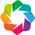

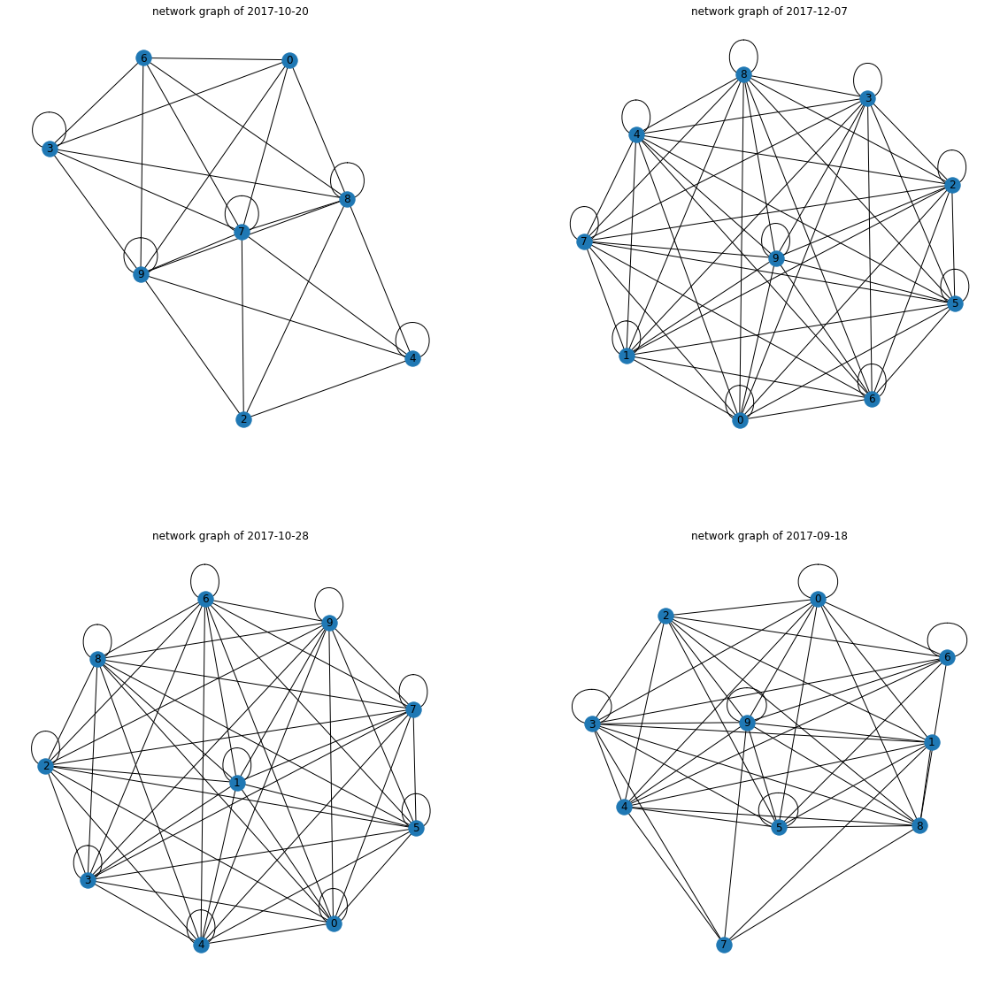

In [217]:
# Let us consider 4 days during which the number of tweets (nodes of the corresponding graph of named entities) is moderately high:

hv.extension('bokeh')
fourDays=["2017-10-20","2017-12-07","2017-10-28","2017-09-18"]

ctype=1
node_color="Girvan-Newman_community"  #'Louvain_community' "connected_component"
bundled=1
nodelabels=0
width=500
height=500
node_size=2*np.log(5+hv.dim('degree')) #4*np.log(6+hv.dim('in-degree'))
node_cmap="tab10"
edge_line_width=1
edge_color='olive'
arrowhead_length=0.04
selection_mode='nodes'
selection_policy="nodes"
edge_hover_line_color='green'
node_hover_fill_color='red'
fontsize={'title': '9pt'}
text_font_size='4pt'
text_color='black'
bgcolor='white'
xoffset=0
yoffset=-0.03 #-15

fig, ((ax0, ax1), (ax2, ax3)) = plt.subplots (nrows=2, ncols=2, figsize=(20,20))

Gh1=GGn[fourDays[0]]
title="%s" %fourDays[0]
pos=graphviz_layout(Gh1)
ax0.set_title('network graph of {}'.format(title))
g0=nx.draw(Gh1, pos, ax=ax0, with_labels=True)

Gh2=GGn[fourDays[1]]
title="%s" %fourDays[1]
pos=graphviz_layout(Gh2)
ax1.set_title('network graph of {}'.format(title))
g1=nx.draw(Gh2, pos, ax=ax1, with_labels=True)


Gh3=GGn[fourDays[2]]
title="%s" %fourDays[2]
pos=graphviz_layout(Gh3)
ax2.set_title('network graph of {}'.format(title))
g2=nx.draw(Gh3, pos, ax=ax2, with_labels=True)

Gh4=GGn[fourDays[3]]
title="%s" %fourDays[3]
pos=graphviz_layout(Gh4)
ax3.set_title('network graph of {}'.format(title))
g3=nx.draw(Gh4, pos, ax=ax3, with_labels=True)



In [245]:
Gha = GGh["2015-03-18"]
#analyze a special 
# NetworkX Centrality Algorithm
eigen_cent = list(nx.eigenvector_centrality(Gha).values())
degree_cent = list(nx.degree_centrality(Gha).values())
close_cent = list(nx.closeness_centrality(Gha).values())
betw_cent = list(nx.betweenness_centrality(Gha).values())
node_name = list(Gha.nodes)


columns = ['Eigenvector','Degree','Closeness','Betweeness', 'hashtag_name']
data = [[eigen_cent[i],
         degree_cent[i],
         close_cent[i],
         betw_cent[i],
         node_name[i]
         ] 
        for i in range(len(eigen_cent))]
dfcent = pd.DataFrame(data,columns=columns) 

dfcent = dfcent.set_index('hashtag_name')
dfcent = dfcent.sort_values(by=['Eigenvector'], ascending = False)

dfcent

,Eigenvector,Degree,Closeness,Betweeness
hashtag_name,,,,
quote,4.036081e-01,0.655172,0.655172,0.123768
quotes,4.036081e-01,0.655172,0.655172,0.123768
tvquotes,3.103959e-01,0.413793,0.478780,0.016626
tvshow,3.103959e-01,0.413793,0.478780,0.016626
HaltandCatchFire,1.960317e-01,0.206897,0.389009,0.000000
DonnaClark,1.960317e-01,0.206897,0.389009,0.000000
KerryBishé,1.960317e-01,0.206897,0.389009,0.000000
AmericanHorrorStory,1.960317e-01,0.206897,0.389009,0.000000
LanaWinters,1.960317e-01,0.206897,0.389009,0.000000


In [ ]:
%%shell
jupyter nbconvert --to html /Assignment_03_Liu.ipynb